In [48]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import os
import sys
import geopandas as gpd
import folium
from shapely.geometry import Point, Polygon
from folium.plugins import MarkerCluster
from folium.plugins import HeatMap
import plotly.express as px
from bokeh.plotting import figure, show
from bokeh.io import output_notebook
from bokeh.transform import cumsum
from math import pi

In [49]:
data = pd.read_csv('atl_crime.csv')
data.head()

,IDCol,Report Number,Report Date,Day Occurred,Day Number,Occur Date,Occur Time,Possible Date,Possible Time,Beat,...,Apartment Number,Crime Type,NIBRS Code,Neighborhood,NPU,Longitude,Latitude,ObjectId,x,y
0,320197,203581105,12/23/2020 0:00,Wednesday,4,12/23/2020,10:00,12/23/2020,16:45,410,...,NaN,BURGLARY,220,Campbellton Road,R,-84.466012,33.702732,1,-9402713.445,3988955.700
1,320198,203581144,12/23/2020 0:00,Wednesday,4,12/23/2020,17:16,12/23/2020,17:30,505,...,NaN,LARCENY-FROM VEHICLE,23F,Midtown,E,-84.387771,33.774764,2,-9394003.697,3998598.283
2,320199,203581174,12/23/2020 0:00,Saturday,7,12/19/2020,21:50,12/19/2020,22:30,211,...,NaN,LARCENY-FROM VEHICLE,23F,Lindbergh/Morosgo,B,-84.366938,33.819892,3,-9391684.578,4004643.485
3,320200,203581238,12/23/2020 0:00,Wednesday,4,12/23/2020,18:05,12/23/2020,18:09,206,...,NaN,AUTO THEFT,240,Buckhead Village,B,-84.376506,33.837935,4,-9392749.683,4007061.360
4,320201,203581247,12/23/2020 0:00,Wednesday,4,12/23/2020,18:12,NaN,NaN,204,...,NaN,LARCENY-NON VEHICLE,23C,Berkeley Park,D,-84.412846,33.804230,5,-9396795.033,4002545.092


In [50]:
road_map = gpd.read_file('roads/tl_2019_13_prisecroads.shp')
road_map = road_map.to_crs(epsg=4326)

geom = [Point(xy) for xy in zip(data['Longitude'], data['Latitude'])]

# Create GeoDataFrame
geo_data = gpd.GeoDataFrame(data, crs="EPSG:4326", geometry=geom)

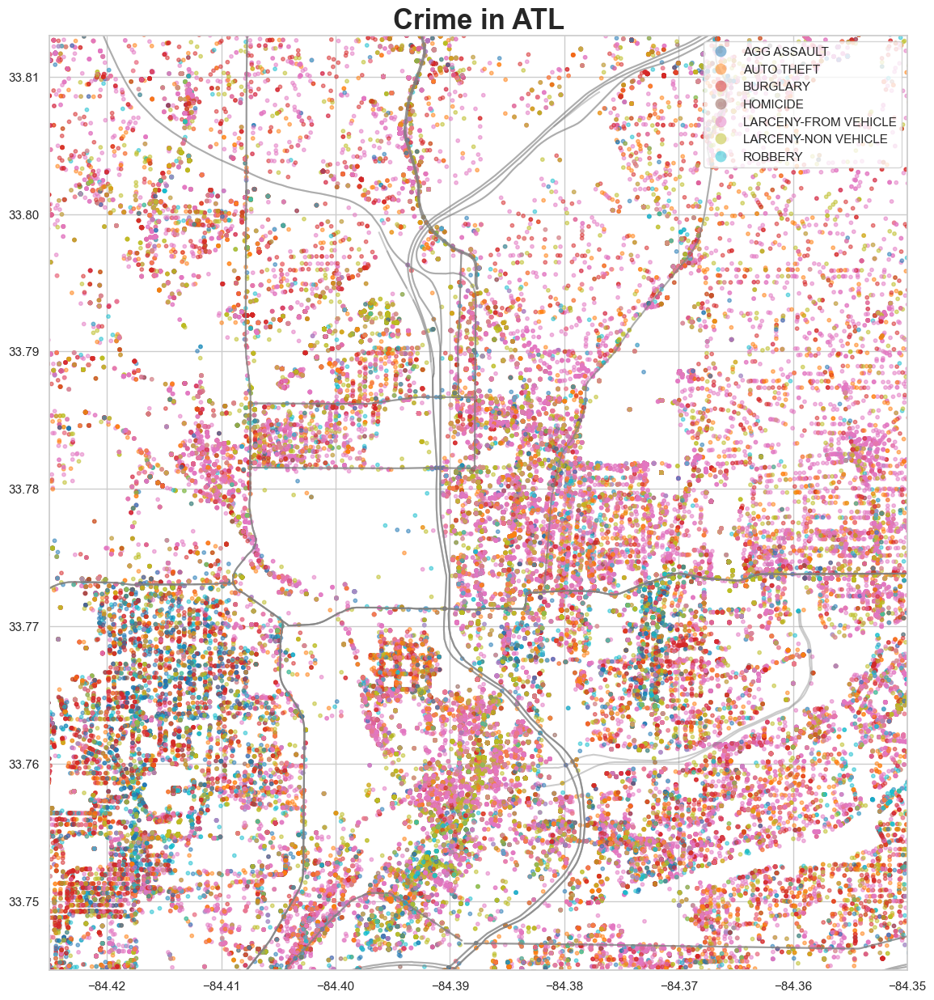

In [51]:
fig, ax = plt.subplots(figsize=(15, 15))

road_map.plot(ax=ax, color='grey', alpha=0.4)

geo_data.plot(column="Crime Type",ax=ax, alpha=0.5, legend =True, markersize=10)

plt.title("Crime in ATL", fontsize=25, fontweight="bold")

plt.xlim(-84.425,-84.35)
plt.ylim(33.745,33.813)

plt.show()


In [52]:
# Group and aggregate data by Crime Type
agg_data = data.groupby('Crime Type')['Crime Type'].count().reset_index(name='Count')

# Create an interactive bar plot using Plotly Express
fig = px.bar(agg_data, x='Crime Type', y='Count', color='Crime Type',
             title='Crime Types Distribution', labels={'x': 'Crime Type', 'y': 'Number of Incidents'},
             template='plotly_white')  # Use white theme for the plot

# Customize x-axis labels rotation
fig.update_xaxes(tickangle=-45)

# Show the interactive plot
fig.show()

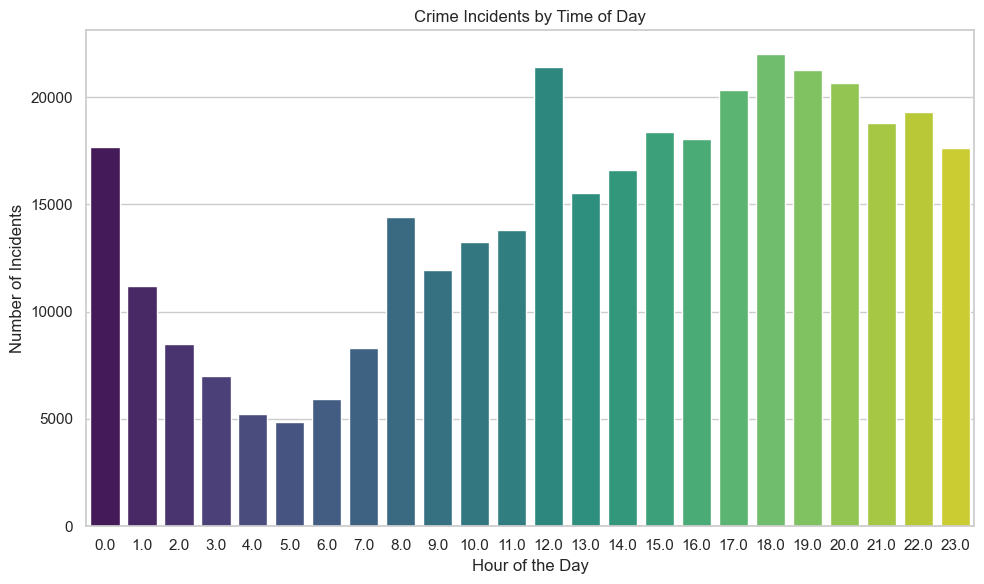

In [53]:

# Convert the 'Report Date' column to datetime format
#data['occur_time'] = pd.to_datetime(data[])
data['occur_time'] = pd.to_datetime(data['Occur Time'], format='%H:%M', errors='coerce')

# Extract the hour from the 'occur_time' column
data['Hour'] = data['occur_time'].dt.hour

# Create a bar plot of crime incidents by hour
plt.figure(figsize=(10, 6))
sns.set(style="whitegrid")
sns.countplot(x='Hour', data=data, palette='viridis')
plt.xlabel('Hour of the Day')
plt.ylabel('Number of Incidents')
plt.title('Crime Incidents by Time of Day')
plt.tight_layout()

# Show the plot
plt.show()



In [54]:

# Load your crime data
data = pd.read_csv('atl_crime.csv')

# Group data by Day Occurred and count the occurrences
day_counts = data['Day Occurred'].value_counts()

# Prepare data for the pie chart
day_counts = day_counts.reset_index()
day_counts.columns = ['Day', 'Count']

# Calculate the cumulative sum of counts for angles
day_counts['angle'] = day_counts['Count']/day_counts['Count'].sum() * 2*pi
day_counts['color'] = ['#1f77b4', '#ff7f0e', '#2ca02c', '#d62728', '#9467bd', '#8c564b', '#e377c2']

# Create the Bokeh figure
p = figure(width=600, height=400, title="Crimes by Day Occurred", toolbar_location=None,
           tools="hover", tooltips="@Day: @Count")

# Add the pie chart
p.wedge(x=0, y=1, radius=0.4, 
        start_angle=cumsum('angle', include_zero=True), end_angle=cumsum('angle'),
        line_color="white", fill_color='color', legend_field='Day', source=day_counts)

# Customize the plot
p.axis.axis_label = None
p.axis.visible = False
p.grid.grid_line_color = None

# Show the plot in the notebook
output_notebook()
show(p)


Loading BokehJS ...

In [55]:


# Load your crime data
data = pd.read_csv('atl_crime.csv')

# Convert the 'Report Date' column to datetime format
data['Report Date'] = pd.to_datetime(data['Report Date'], format='%m/%d/%Y %H:%M')

# Filter data for dates starting from 2008
data = data[data['Report Date'] >= pd.to_datetime('2008-01-01')]

# Extract year from 'Report Date'
data['Year'] = data['Report Date'].dt.year

# Define the extent for Atlanta
atl_extent = [-84.5501, -84.2897, 33.6473, 33.8869]

# Create a scatter map using Plotly Express
fig = px.scatter_mapbox(data,
                        lat='Latitude',
                        lon='Longitude',
                        animation_frame='Year',  # Use the 'Year' for animation
                        color='Crime Type',  # Use 'Crime Type' for color differentiation
                        color_discrete_map={'BURGLARY': 'red', 'LARCENY-FROM VEHICLE': 'blue', 
                                            'AUTO THEFT': 'green', 'LARCENY-NON VEHICLE': 'purple',
                                            'AGG ASSAULT': 'orange', 'HOMICIDE': 'pink', 'ROBBERY': 'yellow'},
                        title='Crime Heatmap Over Time',
                        mapbox_style="carto-darkmatter",  # Use carto-darkmatter style
                        width=800, height=600,  # Set width and height of the map
                        center={'lat': 33.7675, 'lon': -84.4200},  # Center on Atlanta
                        zoom=10)  # Set initial zoom level

# Show the animation
fig.show()


In [56]:
# Load your crime data
data = pd.read_csv('atl_crime.csv')

# Convert the 'Occur Date' column to datetime format with the correct date format
data['Date'] = pd.to_datetime(data['Occur Date'], format='%m/%d/%Y', errors='coerce')

# Filter data to include only dates from 2008 onwards
data = data[data['Date'].dt.year >= 2008]

# Group the data by date and crime type to get the counts
crime_counts = data.groupby(['Date', 'Crime Type']).size().unstack(fill_value=0)

# Calculate cumulative sum of occurrences for each crime type over time
cumulative_counts = crime_counts.cumsum()

# Create an interactive line plot using Plotly Express
fig = px.line(cumulative_counts, x=cumulative_counts.index, y=cumulative_counts.columns,
              title='Trends in Crime Types', labels={'x': 'Date', 'y': 'Cumulative Count'},
              template='plotly_dark')  # Use dark theme for the plot

# Show the interactive plot
fig.show()

In [57]:

# Create a list of unique crime types
crime_types = data['Crime Type'].unique()

# Create a dictionary to store heatmaps for each crime type
crime_heatmaps = {}

# Generate heatmaps for each crime type
for crime_type in crime_types:
    crime_data = data[data['Crime Type'] == crime_type]
    heat_data = [[row['Latitude'], row['Longitude']] for idx, row in crime_data.iterrows()]
    heat_map = folium.Map(location=[33.7791, -84.3880], zoom_start=13, tiles='CartoDB dark_matter')
    HeatMap(heat_data).add_to(heat_map)
    crime_heatmaps[crime_type] = heat_map

# Display the heatmaps for each crime type
for crime_type, heat_map in crime_heatmaps.items():
    print(f"Heatmap for {crime_type}")
    display(heat_map)

Heatmap for BURGLARY


Heatmap for LARCENY-FROM VEHICLE


Heatmap for AUTO THEFT


Heatmap for LARCENY-NON VEHICLE


Heatmap for AGG ASSAULT


Heatmap for HOMICIDE


Heatmap for ROBBERY


In [58]:
# Create a Folium map with black-themed tiles
atl_map = folium.Map(location=[33.7791, -84.3880], zoom_start=13, tiles='CartoDB dark_matter')

# Create a MarkerCluster for better performance with many markers
marker_cluster = MarkerCluster().add_to(atl_map)

# Add the GeoDataFrame's points to the MarkerCluster
for idx, row in geo_data.iterrows():
    folium.Marker(
        location=[row['Latitude'], row['Longitude']],
        icon=None,  # Disable the default icon
        popup=row['Crime Type'],  # Use Crime Type as the popup content
    ).add_to(marker_cluster)

# Display the map
atl_map.save('crime_density_map.html')  # Save the map as an HTML file